In [1]:
import numpy as np
import scipy
import cv2
import matplotlib.pyplot as plt
import time

# **PART 1**

## PART 1.1



In [2]:
image_of_me = cv2.imread('project2_images/image_of_me.jpg', cv2.IMREAD_GRAYSCALE)
image_of_me = cv2.resize(image_of_me, (0, 0), fx=0.5, fy=0.5)
cv2.imwrite('project2_images/image_of_me.jpg', image_of_me)

True

In [3]:
def conv_with_four_loops(image, kernel):
    kernel_h, kernel_w = kernel.shape
    padding_h, padding_w = kernel_h // 2, kernel_w // 2
    image_padded = np.pad(image, ((padding_h, padding_h), (padding_w, padding_w)), mode='constant')
    kernel_flipped = np.flip(kernel, axis=(0, 1))
    result_image = np.zeros_like(image)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            for k in range(kernel_h):
                for l in range(kernel_w):
                    result_image[i, j] += image_padded[i + k, j + l] * kernel_flipped[k, l]

    return result_image

In [4]:
def conv_with_two_loops(image, kernel):
    kernel_h, kernel_w = kernel.shape
    padding_h, padding_w = kernel_h // 2, kernel_w // 2
    image_padded = np.pad(image, ((padding_h, padding_h), (padding_w, padding_w)), mode='constant')
    kernel_flipped = np.flip(kernel, axis=(0, 1))
    result_image = np.zeros_like(image)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            result_image[i, j] = np.dot(
                image_padded[i:i+kernel_h, j:j+kernel_w].ravel(),
                kernel_flipped.ravel()
            )

    return result_image

In [5]:
image_of_me = cv2.imread('project2_images/image_of_me.jpg', cv2.IMREAD_GRAYSCALE)
image_of_me = image_of_me.astype(np.float64) / 255.0
box_filter = np.ones((3, 3)) / 9
Dx = np.array([[1, 0, -1]])
Dy = Dx.T

In [102]:
# four for loops
start_time = time.time()
four_loop_box = conv_with_four_loops(image_of_me, box_filter)
four_loop_box_time = time.time() - start_time

# two for loops
start_time = time.time()
two_loop_box = conv_with_two_loops(image_of_me, box_filter)
two_loop_box_time = time.time() - start_time

# scipy version
start_time = time.time()
scipy_box = scipy.signal.convolve2d(image_of_me, box_filter, mode='same', boundary='fill', fillvalue=0)
scipy_box_time = time.time() - start_time

print(f"Four loop time: {four_loop_box_time} seconds")
print(f"Two loop time: {two_loop_box_time} seconds")
print(f"SciPy time: {scipy_box_time} seconds")

Four loop time: 0.398967981338501 seconds
Two loop time: 0.16913676261901855 seconds
SciPy time: 0.002880096435546875 seconds


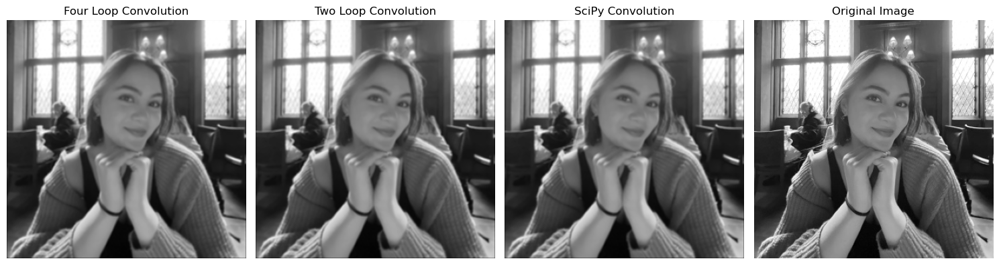

In [7]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 4, 1)
plt.imshow(four_loop_box, cmap='gray')
plt.title('Four Loop Convolution')
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(two_loop_box, cmap='gray')
plt.title('Two Loop Convolution')
plt.axis('off')


plt.subplot(1, 4, 3)
plt.imshow(scipy_box, cmap='gray')
plt.title('SciPy Convolution')
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(image_of_me, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/box_filter_comparison_image_of_me.jpg')
plt.show()

In [103]:
assert np.allclose(four_loop_box, two_loop_box)
assert np.allclose(four_loop_box, scipy_box)
assert np.allclose(two_loop_box, scipy_box)

In [9]:
assert not np.allclose(four_loop_box, image_of_me)
assert not np.allclose(two_loop_box, image_of_me)
assert not np.allclose(scipy_box, image_of_me)

In [10]:
four_loop_Dx = conv_with_four_loops(image_of_me, Dx)
four_loop_Dy = conv_with_four_loops(image_of_me, Dy)
two_loop_Dx = conv_with_two_loops(image_of_me, Dx)
two_loop_Dy = conv_with_two_loops(image_of_me, Dy)
scipy_Dx = scipy.signal.convolve2d(image_of_me, Dx, mode='same', boundary='fill', fillvalue=0)
scipy_Dy = scipy.signal.convolve2d(image_of_me, Dy, mode='same', boundary='fill', fillvalue=0)


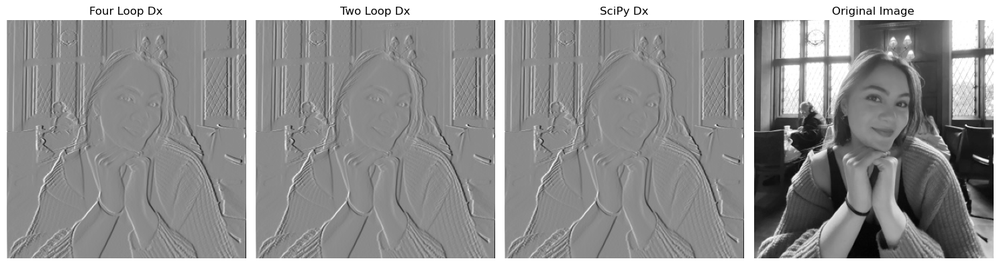

In [146]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 4, 1)
plt.imshow(four_loop_Dx, cmap='gray')
plt.title('Four Loop Dx')
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(two_loop_Dx, cmap='gray')
plt.title('Two Loop Dx')
plt.axis('off')

plt.subplot(1, 4, 3)
plt.imshow(scipy_Dx, cmap='gray')
plt.title('SciPy Dx')
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(image_of_me, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/Dx_comparison_image_of_me.jpg')
plt.show()

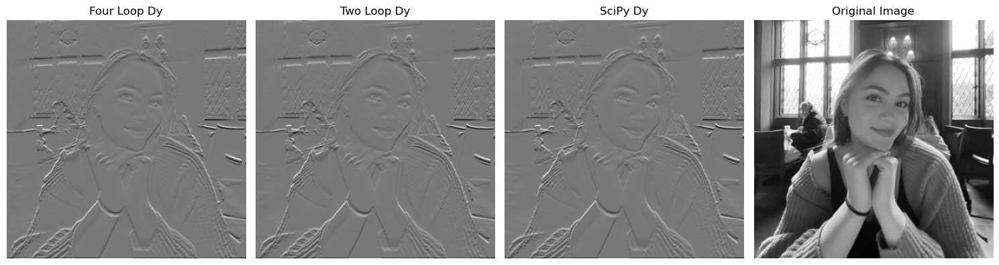

In [148]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 4, 1)
plt.imshow(four_loop_Dy, cmap='gray')
plt.title('Four Loop Dy')
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(two_loop_Dy, cmap='gray')
plt.title('Two Loop Dy')
plt.axis('off')

plt.subplot(1, 4, 3)
plt.imshow(scipy_Dy, cmap='gray')
plt.title('SciPy Dy')
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(image_of_me, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/Dy_comparison_image_of_me.jpg')
plt.show()

In [13]:
assert np.allclose(four_loop_Dx, two_loop_Dx)
assert np.allclose(four_loop_Dx, scipy_Dx)
assert np.allclose(two_loop_Dx, scipy_Dx)
assert not np.allclose(four_loop_Dx, image_of_me)
assert not np.allclose(two_loop_Dx, image_of_me)
assert not np.allclose(scipy_Dx, image_of_me)

assert np.allclose(four_loop_Dy, two_loop_Dy)
assert np.allclose(four_loop_Dy, scipy_Dy)
assert np.allclose(two_loop_Dy, scipy_Dy)
assert not np.allclose(four_loop_Dy, image_of_me)
assert not np.allclose(two_loop_Dy, image_of_me)
assert not np.allclose(scipy_Dy, image_of_me)


## PART 1.2

In [14]:
cameraman_image = cv2.imread('project2_images/cameraman_image.png', 0)
cameraman_image = cameraman_image.astype(np.float64) / 255.0

libpng warning: iCCP: profile 'icc': 0h: PCS illuminant is not D50


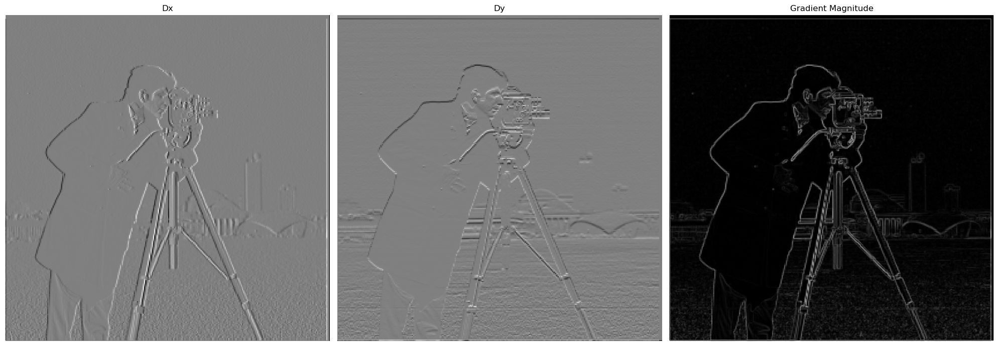

In [100]:
cameraman_dx = scipy.signal.convolve2d(cameraman_image, Dx, mode='same', boundary='fill', fillvalue=0)
cameraman_dy = scipy.signal.convolve2d(cameraman_image, Dy, mode='same', boundary='fill', fillvalue=0)

cameraman_gradient_magnitude = np.sqrt(cameraman_dx**2 + cameraman_dy**2)

plt.figure(figsize=(20, 10))

plt.subplot(1, 3, 1)
plt.imshow(cameraman_dx, cmap='gray')
plt.title('Dx')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(cameraman_dy, cmap='gray')
plt.title('Dy')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(cameraman_gradient_magnitude, cmap='gray')
plt.title('Gradient Magnitude')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/cameraman_gradient_magnitude.jpg')
plt.show()



In [16]:
thresholds = [0.25, 0.275, 0.30, 0.325, 0.35, 0.375]
results = {}

for threshold in thresholds:
    cameraman_edges = cameraman_gradient_magnitude.copy() > threshold
    results[threshold] = cameraman_edges.copy()


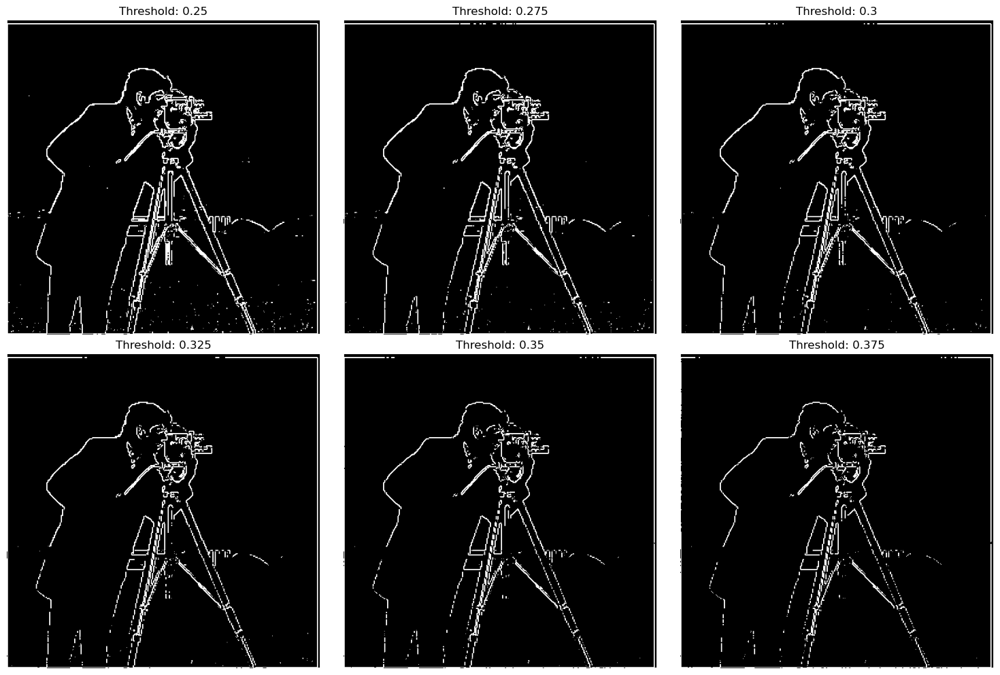

In [17]:
plt.figure(figsize=(15, 10))

for i, (threshold, edges) in enumerate(results.items()):
    plt.subplot(2, len(results) // 2, i + 1)
    plt.imshow(edges, cmap='gray')
    plt.title(f'Threshold: {threshold}')
    plt.axis('off')
    
plt.tight_layout()
plt.savefig('project2_images/cameraman_edges.jpg')
plt.show()


## PART 1.3

In [18]:
gaussian_kernel = cv2.getGaussianKernel(13, 2)
gaussian_kernel = np.outer(gaussian_kernel, gaussian_kernel)

In [19]:
cameraman_smoothed = scipy.signal.convolve2d(cameraman_image, gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
cameraman_smoothed_dx = scipy.signal.convolve2d(cameraman_smoothed, Dx, mode='same', boundary='fill', fillvalue=0)
cameraman_smoothed_dy = scipy.signal.convolve2d(cameraman_smoothed, Dy, mode='same', boundary='fill', fillvalue=0)
cameraman_smoothed_gradient_magnitude = np.sqrt(cameraman_smoothed_dx**2 + cameraman_smoothed_dy**2)

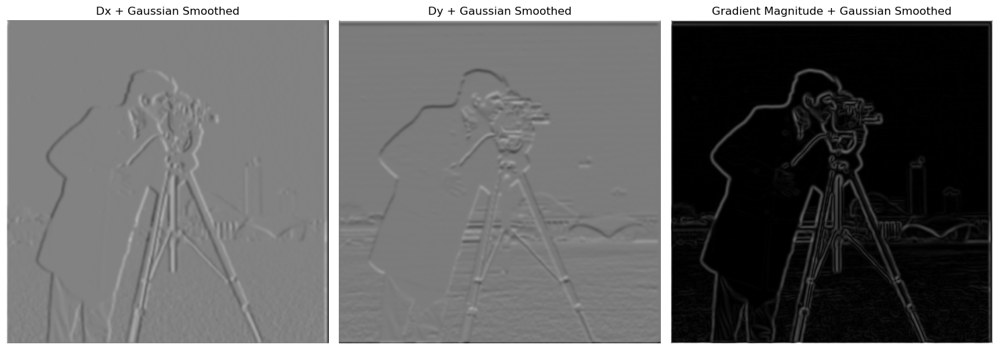

In [20]:
plt.figure(figsize=(15, 10))
plt.subplot(1, 3, 1)
plt.imshow(cameraman_smoothed_dx, cmap='gray')
plt.title('Dx + Gaussian Smoothed')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(cameraman_smoothed_dy, cmap='gray')
plt.title('Dy + Gaussian Smoothed')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(cameraman_smoothed_gradient_magnitude, cmap='gray')
plt.title('Gradient Magnitude + Gaussian Smoothed')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/cameraman_smoothed_dx_dy.jpg')
plt.show()

In [21]:
thresholds = [0.08, 0.09, 0.1, 0.11, 0.12, 0.13]
results = {}

for threshold in thresholds:
    cameraman_edges = cameraman_smoothed_gradient_magnitude.copy() > threshold
    results[threshold] = cameraman_edges.copy()

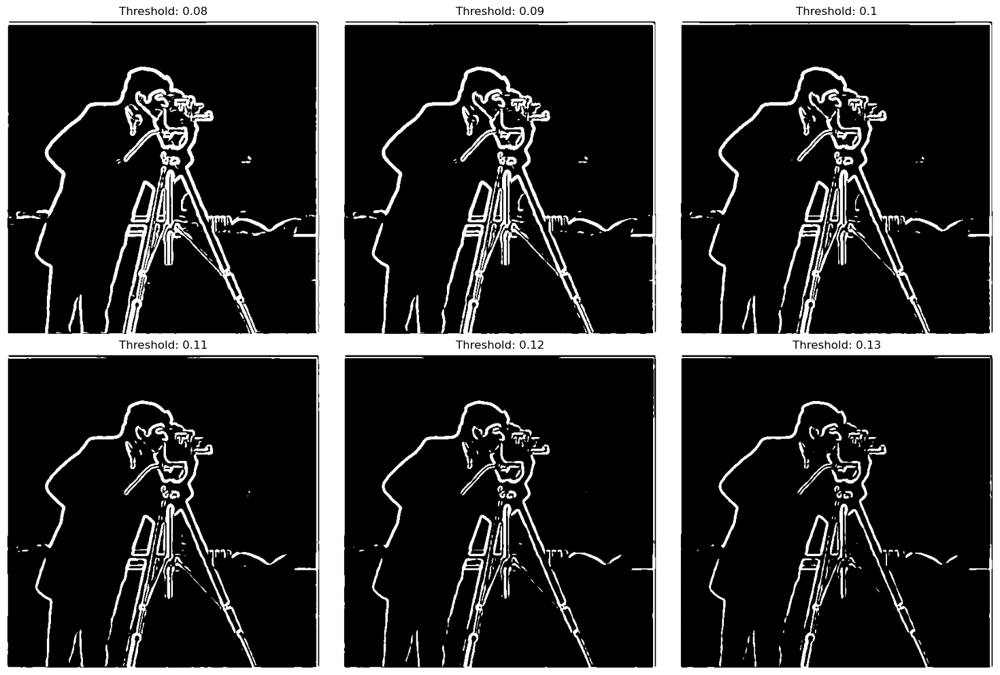

In [22]:
plt.figure(figsize=(15, 10))

for i, (threshold, edges) in enumerate(results.items()):
    plt.subplot(2, len(results) // 2, i + 1)
    plt.imshow(edges, cmap='gray')
    plt.title(f'Threshold: {threshold}')
    plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/cameraman_edges_smoothed.jpg')
plt.show()

In [23]:
dx_gaussian = scipy.signal.convolve2d(gaussian_kernel, Dx, mode='same', boundary='fill', fillvalue=0)
dy_gaussian = scipy.signal.convolve2d(gaussian_kernel, Dy, mode='same', boundary='fill', fillvalue=0)

cameraman_dx_gaussian = scipy.signal.convolve2d(cameraman_image, dx_gaussian, mode='same', boundary='fill', fillvalue=0)
cameraman_dy_gaussian = scipy.signal.convolve2d(cameraman_image, dy_gaussian, mode='same', boundary='fill', fillvalue=0)

cameraman_smoothed_gradient_magnitude_gaussian = np.sqrt(cameraman_dx_gaussian**2 + cameraman_dy_gaussian**2)

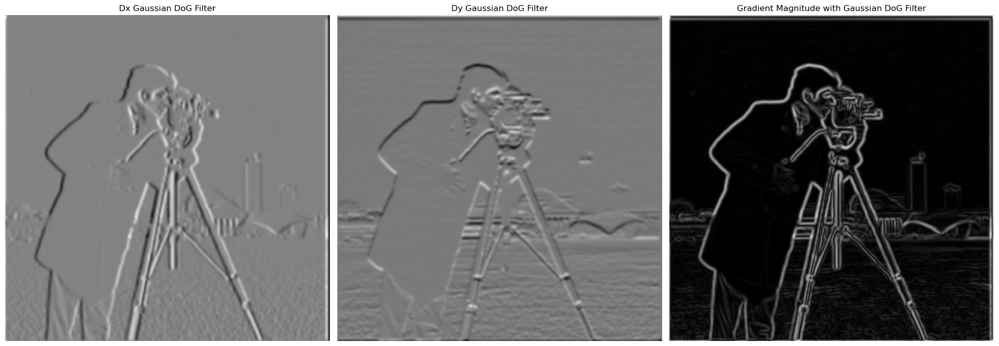

In [101]:
plt.figure(figsize=(20, 10))
plt.subplot(1, 3, 1)
plt.imshow(cameraman_dx_gaussian, cmap='gray')
plt.title('Dx Gaussian DoG Filter')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(cameraman_dy_gaussian, cmap='gray')
plt.title('Dy Gaussian DoG Filter')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(cameraman_smoothed_gradient_magnitude_gaussian, cmap='gray')
plt.title('Gradient Magnitude with Gaussian DoG Filter')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/cameraman_gradient_magnitude_gaussian_dog_filter.jpg')
plt.show()

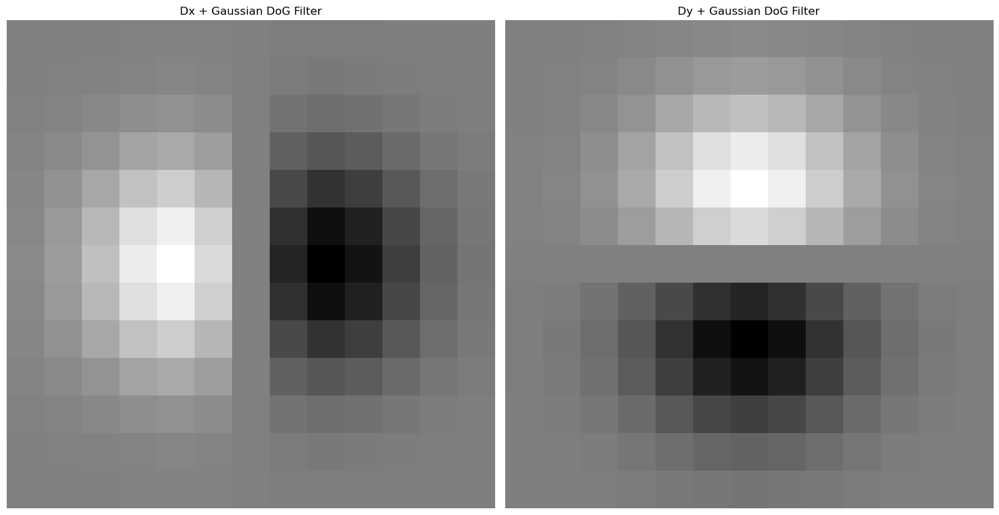

In [94]:
plt.figure(figsize=(15, 10))
plt.subplot(1, 2, 1)
plt.imshow(dx_gaussian, cmap='gray')
plt.title('Dx + Gaussian DoG Filter')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(dy_gaussian, cmap='gray')
plt.title('Dy + Gaussian DoG Filter')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/cameraman_dx_dy_gaussian_dog_filter.jpg')
plt.show()

In [26]:
results_gradient_gaussian = {}

for threshold in thresholds:
    cameraman_edges = cameraman_smoothed_gradient_magnitude_gaussian.copy() > threshold
    results_gradient_gaussian[threshold] = cameraman_edges.copy()

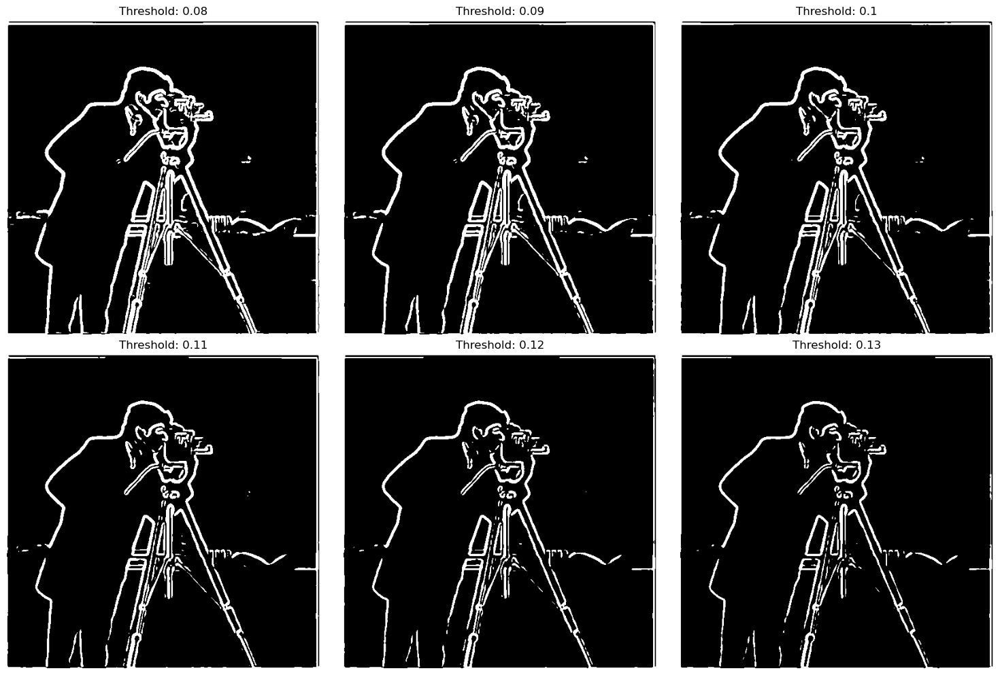

In [27]:
plt.figure(figsize=(15, 10))

for i, (threshold, edges) in enumerate(results_gradient_gaussian.items()):
    plt.subplot(2, len(results_gradient_gaussian) // 2, i + 1)
    plt.imshow(edges, cmap='gray')
    plt.title(f'Threshold: {threshold}')
    plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/cameraman_edges_smoothed_gradient_gaussian.jpg')
plt.show()

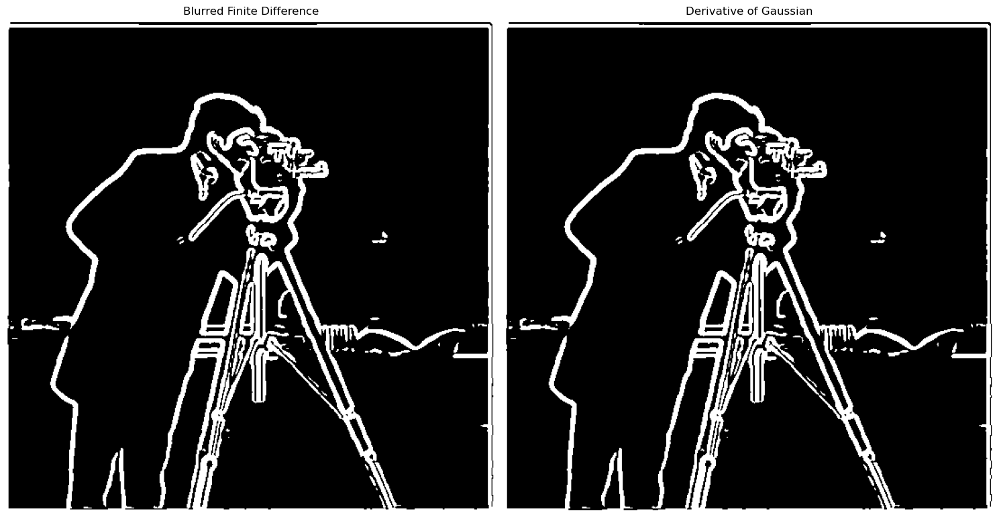

In [104]:
plt.figure(figsize=(15, 10))
plt.subplot(1, 2, 1)
plt.imshow(results[0.08], cmap='gray')
plt.title('Blurred Finite Difference')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(results_gradient_gaussian[0.08], cmap='gray')
plt.title('Derivative of Gaussian')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/cameraman_gradient_magnitude_comparison.jpg')
plt.show()

# **PART 2**

## PART 2.1

In [29]:
def unsharp_mask_filter(image, alpha):
    gaussian_kernel = cv2.getGaussianKernel(7, 1)
    gaussian_kernel = np.outer(gaussian_kernel, gaussian_kernel)
    
    # f + a(f - f*g) = f * ((1 + a)e - ag)
    unit_impulse = np.zeros_like(gaussian_kernel)
    unit_impulse[gaussian_kernel.shape[0]//2, gaussian_kernel.shape[1]//2] = 1
    kernel = (1 + alpha) * unit_impulse - alpha * gaussian_kernel

    sharpened_r = scipy.signal.convolve2d(image[:,:,0], kernel, mode='same', boundary='fill', fillvalue=0)
    sharpened_g = scipy.signal.convolve2d(image[:,:,1], kernel, mode='same', boundary='fill', fillvalue=0)
    sharpened_b = scipy.signal.convolve2d(image[:,:,2], kernel, mode='same', boundary='fill', fillvalue=0)
    
    sharpened_image = np.stack([sharpened_r, sharpened_g, sharpened_b], axis=-1)
    sharpened_image = np.clip(sharpened_image, 0, 1)
    return sharpened_image

In [30]:
taj_image = cv2.imread('project2_images/taj.jpg', cv2.IMREAD_COLOR)
taj_image = cv2.cvtColor(taj_image, cv2.COLOR_BGR2RGB)
taj_image = taj_image.astype(np.float64) / 255.0

In [31]:
taj_results = {}
for alpha in [0.5, 1, 1.5, 2, 2.5]:
    sharpened_taj = unsharp_mask_filter(taj_image, alpha)
    taj_results[alpha] = sharpened_taj

In [109]:
gaussian_kernel = cv2.getGaussianKernel(7, 1)
gaussian_kernel = np.outer(gaussian_kernel, gaussian_kernel)
taj_blurred_r = scipy.signal.convolve2d(taj_image[:,:,0], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
taj_blurred_g = scipy.signal.convolve2d(taj_image[:,:,1], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
taj_blurred_b = scipy.signal.convolve2d(taj_image[:,:,2], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
taj_blurred = np.stack([taj_blurred_r, taj_blurred_g, taj_blurred_b], axis=-1)

In [112]:
taj_high_freq = taj_image - taj_blurred
taj_high_freq_norm = (taj_high_freq - np.min(taj_high_freq)) / (np.max(taj_high_freq) - np.min(taj_high_freq))

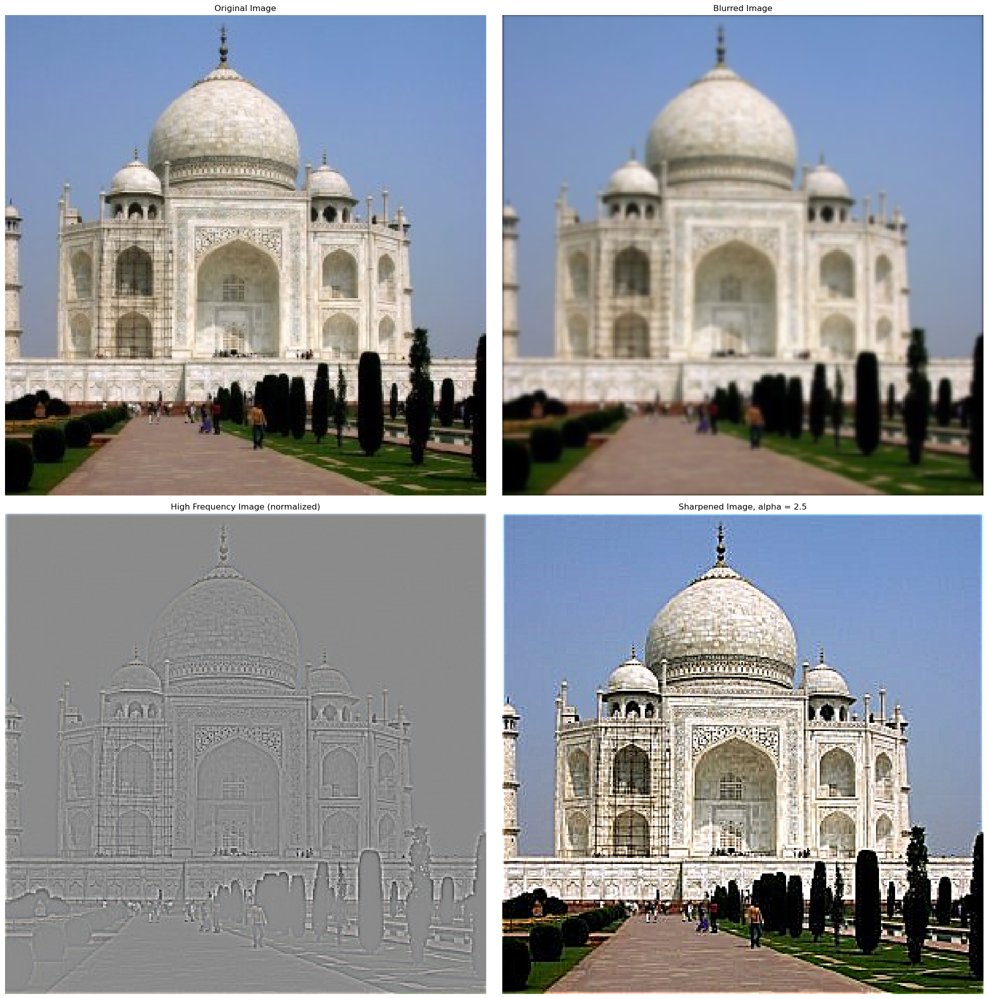

In [114]:
plt.figure(figsize=(20, 20))

plt.subplot(2, 2, 1)
plt.imshow(taj_image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(taj_blurred)
plt.title('Blurred Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(taj_high_freq_norm)
plt.title('High Frequency Image (normalized)')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(taj_results[2.5])
plt.title('Sharpened Image, alpha = 2.5')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/taj_sharpening_results.jpg')

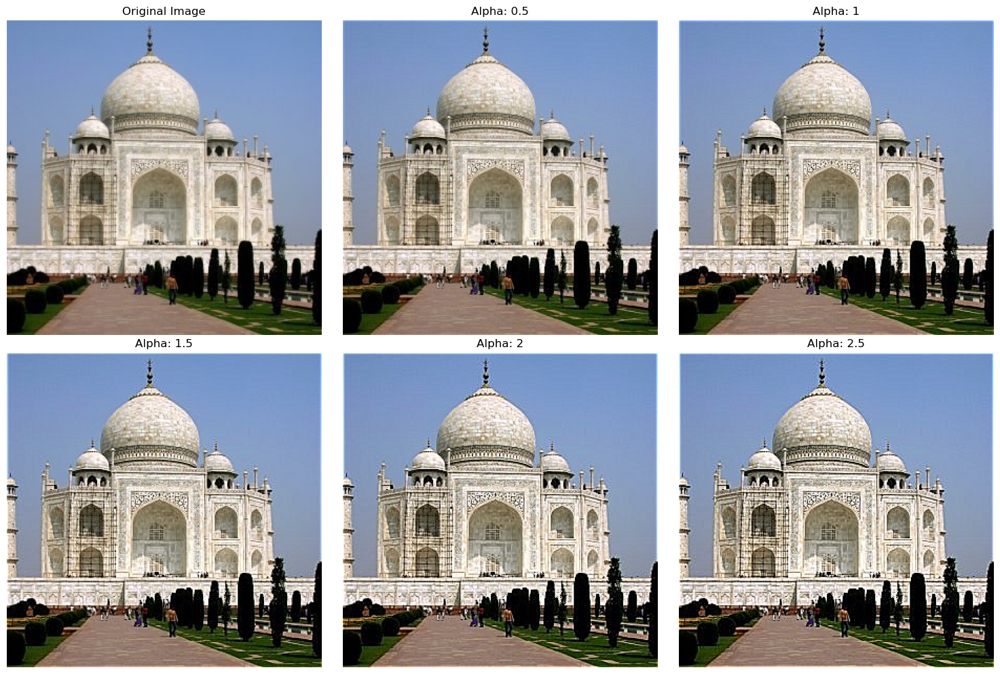

In [119]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 3, 1)
plt.imshow(taj_image)
plt.title('Original Image')
plt.axis('off')

for i, (alpha, sharpened_image) in enumerate(taj_results.items()):
    plt.subplot(2, 3, i + 2)
    plt.imshow(sharpened_image)
    plt.title(f'Alpha: {alpha}')
    plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/taj_all_alpha_values.jpg')

In [115]:
tower_bridge_image = cv2.imread('project2_images/blurry_tower_bridge.jpg', cv2.IMREAD_COLOR)
tower_bridge_image = cv2.cvtColor(tower_bridge_image, cv2.COLOR_BGR2RGB)
tower_bridge_image = tower_bridge_image.astype(np.float64) / 255.0
tower_bridge_results = {}
for alpha in [0.5, 1, 1.5, 2, 2.5]:
    sharpened_tower_bridge = unsharp_mask_filter(tower_bridge_image, alpha)
    tower_bridge_results[alpha] = sharpened_tower_bridge

In [116]:
tower_bridge_blurred_r = scipy.signal.convolve2d(tower_bridge_image[:,:,0], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
tower_bridge_blurred_g = scipy.signal.convolve2d(tower_bridge_image[:,:,1], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
tower_bridge_blurred_b = scipy.signal.convolve2d(tower_bridge_image[:,:,2], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
tower_bridge_blurred = np.stack([tower_bridge_blurred_r, tower_bridge_blurred_g, tower_bridge_blurred_b], axis=-1)
tower_bridge_high_freq = tower_bridge_image - tower_bridge_blurred
tower_bridge_high_freq_norm = (tower_bridge_high_freq - np.min(tower_bridge_high_freq)) / (np.max(tower_bridge_high_freq) - np.min(tower_bridge_high_freq))

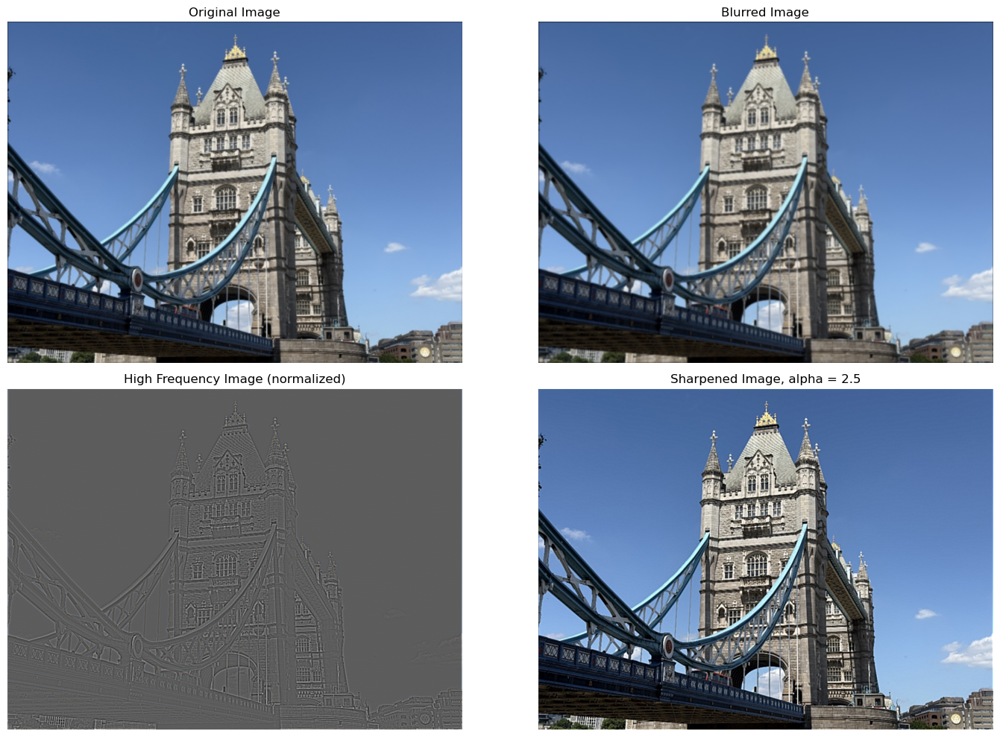

In [117]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(tower_bridge_image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(tower_bridge_blurred)
plt.title('Blurred Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(tower_bridge_high_freq_norm)
plt.title('High Frequency Image (normalized)')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(tower_bridge_results[2.5])
plt.title('Sharpened Image, alpha = 2.5')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/tower_bridge_sharpening_results.jpg')
plt.show()

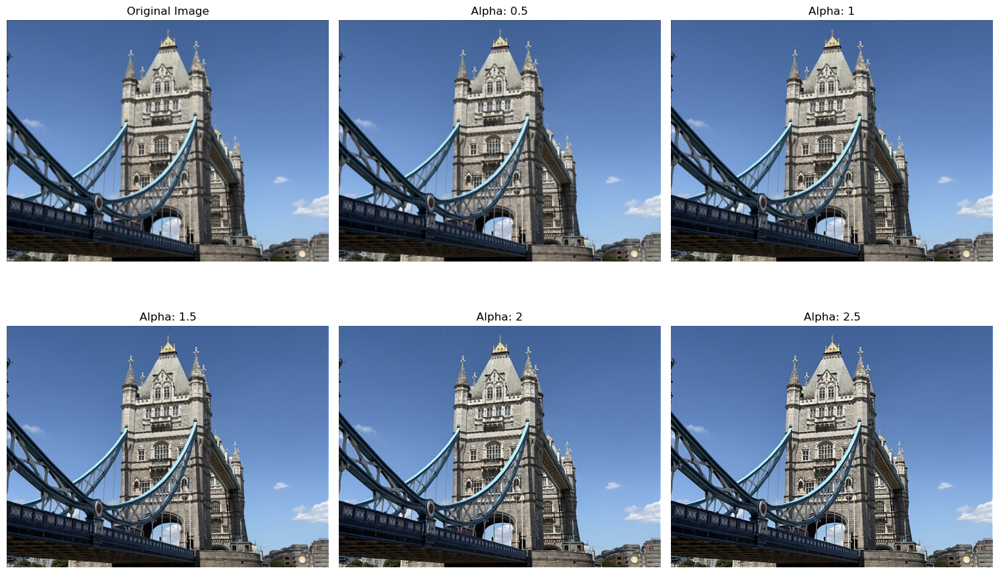

In [121]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 3, 1)
plt.imshow(tower_bridge_image)
plt.title('Original Image')
plt.axis('off')

for i, (alpha, sharpened_image) in enumerate(tower_bridge_results.items()):
    plt.subplot(2, 3, i + 2)
    plt.imshow(sharpened_image)
    plt.title(f'Alpha: {alpha}')
    plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/tower_bridge_all_alpha_values.jpg')


In [34]:
loki_image = cv2.imread('project2_images/loki.jpg', cv2.IMREAD_COLOR)
loki_image = cv2.cvtColor(loki_image, cv2.COLOR_BGR2RGB)
loki_image = loki_image.astype(np.float64) / 255.0

In [123]:
gaussian_kernel = cv2.getGaussianKernel(13, 2)
gaussian_kernel = np.outer(gaussian_kernel, gaussian_kernel)

In [124]:
loki_blurred_r = scipy.signal.convolve2d(loki_image[:,:,0], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
loki_blurred_g = scipy.signal.convolve2d(loki_image[:,:,1], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
loki_blurred_b = scipy.signal.convolve2d(loki_image[:,:,2], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
loki_blurred = np.stack([loki_blurred_r, loki_blurred_g, loki_blurred_b], axis=-1)

In [125]:
loki_blurred_sharpened = unsharp_mask_filter(loki_blurred, 2)

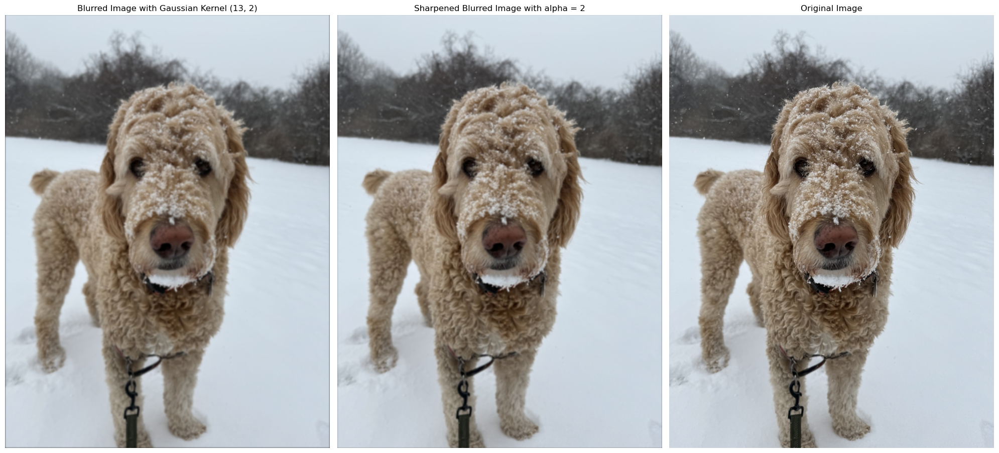

In [126]:
plt.figure(figsize=(20, 10))

plt.subplot(1, 3, 1)
plt.imshow(loki_blurred)
plt.title('Blurred Image with Gaussian Kernel (13, 2)')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(loki_blurred_sharpened)
plt.title('Sharpened Blurred Image with alpha = 2')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(loki_image)
plt.title('Original Image')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/loki_sharpening_results.jpg')
plt.show()


## PART 2.2

In [39]:
def get_low_and_high_pass_filters(image, kernel_size, sigma):
    gaussian_kernel = cv2.getGaussianKernel(kernel_size, sigma)
    gaussian_kernel = np.outer(gaussian_kernel, gaussian_kernel)

    image_r_blur = scipy.signal.convolve2d(image[:,:,0], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
    image_g_blur = scipy.signal.convolve2d(image[:,:,1], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
    image_b_blur = scipy.signal.convolve2d(image[:,:,2], gaussian_kernel, mode='same', boundary='fill', fillvalue=0)

    low_pass_filter = np.stack([image_r_blur, image_g_blur, image_b_blur], axis=-1)
    high_pass_filter = image - low_pass_filter
    
    return low_pass_filter, high_pass_filter

In [40]:
from align_image_code import *

In [41]:
derek_image = cv2.imread('project2_images/DerekPicture.jpg', cv2.IMREAD_COLOR)
nutmeg_image = cv2.imread('project2_images/nutmeg.jpg', cv2.IMREAD_COLOR)

derek_image = cv2.cvtColor(derek_image, cv2.COLOR_BGR2RGB)
nutmeg_image = cv2.cvtColor(nutmeg_image, cv2.COLOR_BGR2RGB)

derek_image = derek_image.astype(np.float64) / 255.0
nutmeg_image = nutmeg_image.astype(np.float64) / 255.0

In [42]:
# ran get points in local python environment, got these points below
pts = ((623.5000000000002, 423.4999999999999), (606.357142857143, 289.21428571428555), (384.8939393939396, 445.2835497835497), (300.39177489177507, 346.9285714285712))

In [43]:
def align_images_with_points(im1, im2, pts):
    im1, im2 = align_image_centers(im1, im2, pts)
    im1, im2 = rescale_images(im1, im2, pts)
    im1, angle = rotate_im1(im1, im2, pts)
    im1, im2 = match_img_size(im1, im2)
    return im1, im2

In [44]:
def get_hybrid_image(im1, im2, pts, sigma1, sigma2, k1, k2, with_im2_low=False, with_color=False):
    im1_aligned, im2_aligned = align_images_with_points(im1, im2, pts)
    im1_low, im1_high = get_low_and_high_pass_filters(im1_aligned, k1, sigma1)
    im2_low, im2_high = get_low_and_high_pass_filters(im2_aligned, k2, sigma2)

    if not with_color:
        im1_high = np.mean(im1_high, axis=-1)
        im2_low = np.mean(im2_low, axis=-1)

    hybrid_image = im1_high + im2_low
    hybrid_image = np.clip(hybrid_image, 0, 1)

    return hybrid_image


In [128]:
hybrid_image = get_hybrid_image(nutmeg_image, derek_image, pts, 9, 7, 55, 43)

(-0.5, 776.5, 1254.5, -0.5)

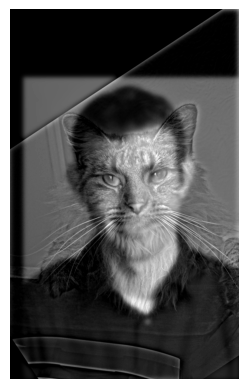

In [129]:
plt.imshow(hybrid_image, cmap="gray")  
plt.axis('off')

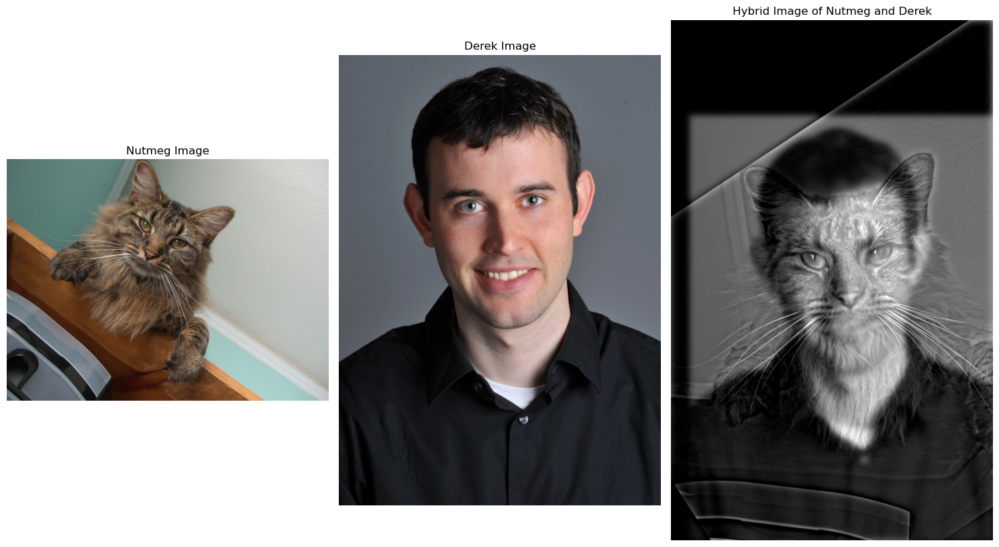

In [131]:
plt.figure(figsize=(15, 10))
plt.subplot(1, 3, 1)
plt.imshow(nutmeg_image)
plt.title('Nutmeg Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(derek_image)
plt.title('Derek Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(hybrid_image, cmap="gray")
plt.title('Hybrid Image of Nutmeg and Derek')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/derek_nutmeg_hybrid_image.jpg')
plt.show()

In [47]:
hybrid_image = hybrid_image * 255
hybrid_image = hybrid_image.astype(np.uint8)
cv2.imwrite('project2_images/derek_nutmeg_hybrid_image.jpg', hybrid_image)

True

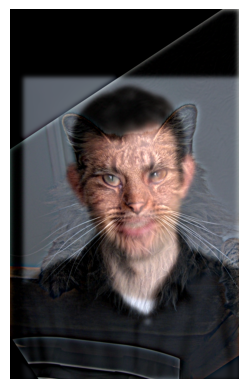

In [48]:
derek_nutmeg_hybrid_color = get_hybrid_image(nutmeg_image, derek_image, pts, 9, 7, 55, 43, with_color=True)
plt.imshow(derek_nutmeg_hybrid_color)
plt.axis('off')
plt.savefig('project2_images/derek_nutmeg_hybrid_image_color.jpg')
plt.show()

In [49]:
broccoli_image = cv2.imread('project2_images/broccoli.jpeg', cv2.IMREAD_COLOR)
broccoli_image = cv2.cvtColor(broccoli_image, cv2.COLOR_BGR2RGB)
broccoli_image = broccoli_image.astype(np.float64) / 255.0

tree_image = cv2.imread('project2_images/tree.jpeg', cv2.IMREAD_COLOR)
tree_image = cv2.cvtColor(tree_image, cv2.COLOR_BGR2RGB)
tree_image = tree_image.astype(np.float64) / 255.0

In [50]:
print(broccoli_image.shape)
print(tree_image.shape)

(246, 205, 3)
(183, 275, 3)


In [51]:
# points found by running align_image_code.py in terminal
broccoli_tree_pts = ((108.32305194805191, 243.03733766233768), (98.33928571428568, 91.28409090909093), (151.1381048387097, 166.45866935483872), (146.42540322580646, 97.9858870967742))

In [52]:
broccoli_tree_hybrid = get_hybrid_image(broccoli_image, tree_image, broccoli_tree_pts, 2, 2, 13, 13, with_color=True)

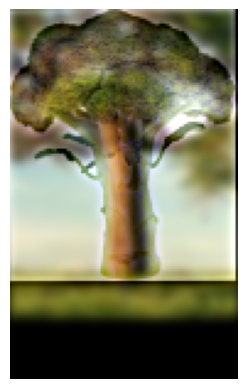

In [53]:
plt.imshow(broccoli_tree_hybrid)
plt.axis('off')
plt.savefig('project2_images/broccoli_tree_hybrid.jpg')
plt.show()

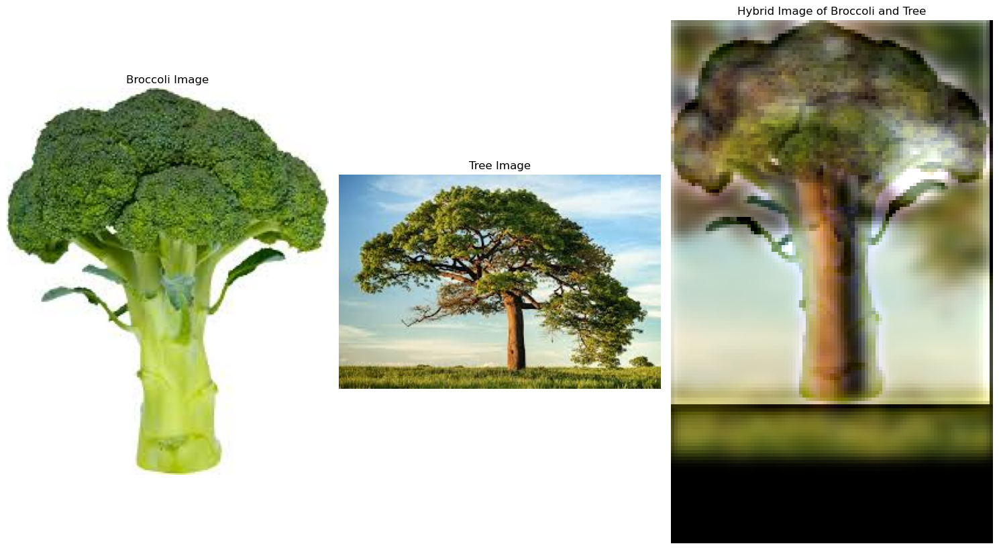

In [132]:
plt.figure(figsize=(15, 10))

plt.subplot(1, 3, 1)
plt.imshow(broccoli_image)
plt.title('Broccoli Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(tree_image)
plt.title('Tree Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(broccoli_tree_hybrid)
plt.title('Hybrid Image of Broccoli and Tree')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/broccoli_tree_hybrid.jpg')

In [54]:
airplane_image = cv2.imread('project2_images/airplane.jpeg', cv2.IMREAD_COLOR)
airplane_image = cv2.cvtColor(airplane_image, cv2.COLOR_BGR2RGB)
airplane_image = airplane_image.astype(np.float64) / 255.0

bird_image = cv2.imread('project2_images/bird.jpg', cv2.IMREAD_COLOR)
bird_image = cv2.cvtColor(bird_image, cv2.COLOR_BGR2RGB)
bird_image = bird_image.astype(np.float64) / 255.0

In [55]:
# points found by running align_image_code.py in terminal
eagle_airplane_pts = ((11.974798387096776, 65.2741935483871), (221.5514112903226, 118.22278225806453), (132.9828629032258, 82.7667338709677), (275.86592741935476, 124.1276209677419))

In [56]:
eagle_airplane_hybrid = get_hybrid_image(airplane_image, bird_image, eagle_airplane_pts, 5, 2, 31, 13, with_color=True)

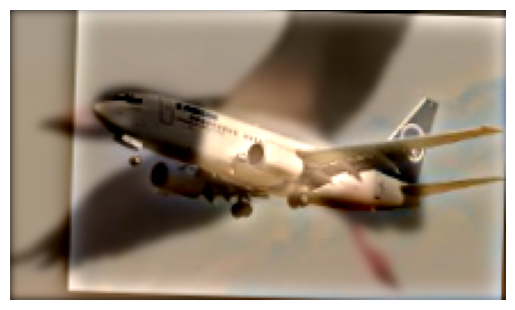

In [57]:
plt.imshow(eagle_airplane_hybrid)
plt.axis('off')
plt.savefig('project2_images/bird_airplane_hybrid.jpg')
plt.show()


In [58]:
airplane_aligned, bird_aligned = align_images_with_points(airplane_image, bird_image, eagle_airplane_pts)
print(bird_aligned.shape)
print(airplane_aligned.shape)

(127, 217, 3)
(127, 217, 3)


In [59]:
bird_gray = np.mean(bird_aligned, axis=-1)
bird_gray = np.clip(bird_gray, 0, 1)
bird_fft = np.log(np.abs(np.fft.fftshift(np.fft.fft2(bird_gray))))

bird_blurred, _ = get_low_and_high_pass_filters(bird_aligned, 13, 2)
bird_blurred_gray = np.mean(bird_blurred, axis=-1)
bird_blurred_gray = np.clip(bird_blurred_gray, 0, 1)
bird_blurred_fft = np.log(np.abs(np.fft.fftshift(np.fft.fft2(bird_blurred_gray))))

airplane_gray = np.mean(airplane_aligned, axis=-1)
airplane_gray = np.clip(airplane_gray, 0, 1)
airplane_fft = np.log(np.abs(np.fft.fftshift(np.fft.fft2(airplane_gray))))

_, airplane_high_freq = get_low_and_high_pass_filters(airplane_aligned, 31, 5)
airplane_high_freq_gray = np.mean(airplane_high_freq, axis=-1)
airplane_high_freq_gray = np.clip(airplane_high_freq_gray, 0, 1)
airplane_high_freq_fft = np.log(np.abs(np.fft.fftshift(np.fft.fft2(airplane_high_freq_gray))))

hybrid_image = airplane_high_freq + bird_blurred
hybrid_image = np.clip(hybrid_image, 0, 1)
hybrid_image_gray = np.mean(hybrid_image, axis=-1)

hybrid_fft = np.log(np.abs(np.fft.fftshift(np.fft.fft2(hybrid_image_gray))))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


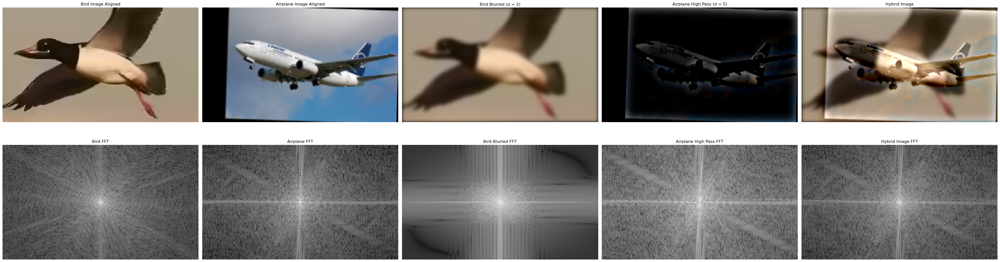

In [60]:
plt.figure(figsize=(40, 12))

plt.subplot(2, 5, 1)
plt.imshow(bird_aligned)
plt.title('Bird Image Aligned')
plt.axis('off')

plt.subplot(2, 5, 2)
plt.imshow(airplane_aligned)
plt.title('Airplane Image Aligned')
plt.axis('off')

plt.subplot(2, 5, 3)
plt.imshow(bird_blurred)
plt.title('Bird Blurred (σ = 2)')
plt.axis('off')

plt.subplot(2, 5, 4)
plt.imshow(airplane_high_freq)
plt.title('Airplane High Pass (σ = 5)')
plt.axis('off')

plt.subplot(2, 5, 5)
plt.imshow(hybrid_image)
plt.title('Hybrid Image')
plt.axis('off')

plt.subplot(2, 5, 6)
plt.imshow(bird_fft, cmap='gray')
plt.title('Bird FFT')
plt.axis('off')

plt.subplot(2, 5, 7)
plt.imshow(airplane_fft, cmap='gray')
plt.title('Airplane FFT')
plt.axis('off')

plt.subplot(2, 5, 8)
plt.imshow(bird_blurred_fft, cmap='gray')
plt.title('Bird Blurred FFT')
plt.axis('off')

plt.subplot(2, 5, 9)
plt.imshow(airplane_high_freq_fft, cmap='gray')
plt.title('Airplane High Pass FFT')
plt.axis('off')

plt.subplot(2, 5, 10)
plt.imshow(hybrid_fft, cmap='gray')
plt.title('Hybrid Image FFT')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/bird_airplane_hybrid_fft.jpg')
plt.show()


## PART 2.3

In [61]:
def get_gaussian_stack(image, starting_sigma = 1, num_levels = 5, sigma_step = 2):
    num_channels = image.shape[2] if len(image.shape) > 2 else 1
    gaussian_stack = []
    for i in range(num_levels):
        kernel_size = int(np.ceil(6 * starting_sigma + 1))
        gaussian_kernel = cv2.getGaussianKernel(kernel_size, starting_sigma)
        gaussian_kernel = np.outer(gaussian_kernel, gaussian_kernel)

        if num_channels == 1:
            blurred_image = scipy.signal.convolve2d(image, gaussian_kernel, mode='same', boundary='symm')
            blurred_image = np.expand_dims(blurred_image, axis=-1)
        else:
            red_blur = scipy.signal.convolve2d(image[:,:,0], gaussian_kernel, mode='same', boundary='symm')
            green_blur = scipy.signal.convolve2d(image[:,:,1], gaussian_kernel, mode='same', boundary='symm')
            blue_blur = scipy.signal.convolve2d(image[:,:,2], gaussian_kernel, mode='same', boundary='symm')
            blurred_image = np.stack([red_blur, green_blur, blue_blur], axis=-1)
        
        gaussian_stack.append(blurred_image)
        starting_sigma *= sigma_step
    return gaussian_stack

In [62]:
def get_laplacian_stack(image, starting_sigma = 1, num_levels = 5, sigma_step = 2):
    gaussian_stack = get_gaussian_stack(image, starting_sigma, num_levels, sigma_step)
    gaussian_stack.insert(0, image)
    laplacian_stack = []
    for i in range(num_levels):
        if i == num_levels - 1:
            laplacian = gaussian_stack[i]
        else:
            laplacian = gaussian_stack[i] - gaussian_stack[i+1]
        laplacian_stack.append(laplacian)
    return laplacian_stack

In [63]:
apple_image = cv2.imread('project2_images/apple.jpeg', cv2.IMREAD_COLOR)
apple_image = cv2.cvtColor(apple_image, cv2.COLOR_BGR2RGB)
apple_image = apple_image.astype(np.float64) / 255.0

orange_image = cv2.imread('project2_images/orange.jpeg', cv2.IMREAD_COLOR)
orange_image = cv2.cvtColor(orange_image, cv2.COLOR_BGR2RGB)
orange_image = orange_image.astype(np.float64) / 255.0

print(apple_image.shape)
print(orange_image.shape)

(300, 300, 3)
(300, 300, 3)


In [64]:
apple_laplacian_stack = get_laplacian_stack(apple_image, starting_sigma = 1, num_levels = 5, sigma_step = 2)
orange_laplacian_stack = get_laplacian_stack(orange_image, starting_sigma = 1, num_levels = 5, sigma_step = 2)

In [150]:
initial_mask = np.zeros_like(apple_image[:,:,0])
half_x = apple_image.shape[1] // 2
initial_mask[:, :half_x] = 1
mask_gaussian_stack = get_gaussian_stack(initial_mask, starting_sigma = 1, num_levels = 5, sigma_step = 2)

In [151]:
apple_masked = []
orange_masked = []
recombined_image = []

current_apple = None
current_orange = None
current_recombined = None

for i in range(5):
    apple = apple_laplacian_stack[i] * mask_gaussian_stack[i]
    orange = orange_laplacian_stack[i] * (1 - mask_gaussian_stack[i])
    recombined = apple + orange

    current_apple = apple if current_apple is None else current_apple + apple
    current_orange = orange if current_orange is None else current_orange + orange
    current_recombined = apple + orange if current_recombined is None else current_recombined + apple + orange

    apple_masked.append(np.clip(apple, 0, 1))
    orange_masked.append(np.clip(orange, 0, 1))
    recombined_image.append(np.clip(recombined, 0, 1))

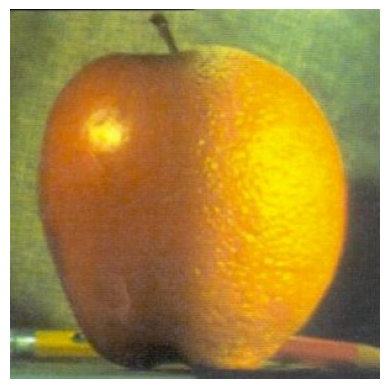

In [152]:
current_apple = np.clip(current_apple, 0, 1)
current_orange = np.clip(current_orange, 0, 1)
current_recombined = np.clip(current_recombined, 0, 1)

plt.imshow(current_recombined)
plt.axis('off')
plt.show()

In [153]:
def normalize_image(img):
    img_normed = (img - np.min(img)) / (np.max(img) - np.min(img))
    return img_normed

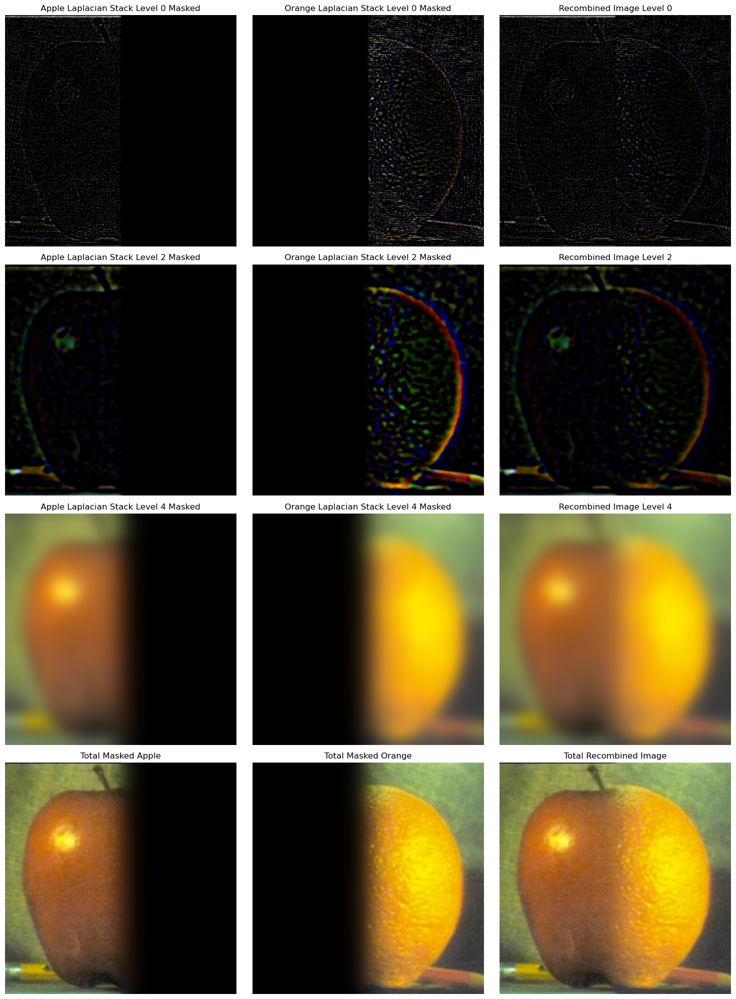

In [154]:
plt.figure(figsize=(15, 20))

plt.subplot(4, 3, 1)
plt.imshow(normalize_image(apple_masked[0]))
plt.title('Apple Laplacian Stack Level 0 Masked')
plt.axis('off')

plt.subplot(4, 3, 2)
plt.imshow(normalize_image(orange_masked[0]))
plt.title('Orange Laplacian Stack Level 0 Masked')
plt.axis('off')

plt.subplot(4, 3, 3)
plt.imshow(normalize_image(recombined_image[0]))
plt.title('Recombined Image Level 0')
plt.axis('off')

plt.subplot(4, 3, 4)
plt.imshow(normalize_image(apple_masked[2]))
plt.title('Apple Laplacian Stack Level 2 Masked')
plt.axis('off')

plt.subplot(4, 3, 5)
plt.imshow(normalize_image(orange_masked[2]))
plt.title('Orange Laplacian Stack Level 2 Masked')
plt.axis('off')

plt.subplot(4, 3, 6)
plt.imshow(normalize_image(recombined_image[2]))
plt.title('Recombined Image Level 2')
plt.axis('off')

plt.subplot(4, 3, 7)
plt.imshow(normalize_image(apple_masked[4]))
plt.title('Apple Laplacian Stack Level 4 Masked')
plt.axis('off')

plt.subplot(4, 3, 8)
plt.imshow(normalize_image(orange_masked[4]))
plt.title('Orange Laplacian Stack Level 4 Masked')
plt.axis('off')

plt.subplot(4, 3, 9)
plt.imshow(normalize_image(recombined_image[4]))
plt.title('Recombined Image Level 4')
plt.axis('off')

plt.subplot(4, 3, 10)
plt.imshow(normalize_image(current_apple))
plt.title('Total Masked Apple')
plt.axis('off')

plt.subplot(4, 3, 11)
plt.imshow(normalize_image(current_orange))
plt.title('Total Masked Orange')
plt.axis('off')

plt.subplot(4, 3, 12)
plt.imshow(normalize_image(current_recombined))
plt.title('Total Recombined Image')
plt.axis('off')

plt.tight_layout()
plt.savefig('project2_images/apple_orange_recombined.jpg')
plt.show()

## PART 2.4

In [70]:
twenty_percent_oraple_mask = np.zeros_like(apple_image[:,:,0])
half_x = apple_image.shape[1] // 2
twenty_percent = apple_image.shape[1] * 0.2
twenty_percent_oraple_mask[:, :half_x] = 1
twenty_percent_oraple_mask[:, int(np.floor(half_x - twenty_percent)):int(np.ceil(half_x + twenty_percent))] = np.linspace(1, 0, int(np.ceil(half_x + twenty_percent)) - int(np.floor(half_x - twenty_percent)))
twenty_percent_oraple_mask_gaussian_stack = get_gaussian_stack(twenty_percent_oraple_mask, starting_sigma = 1, num_levels = 5, sigma_step = 2)

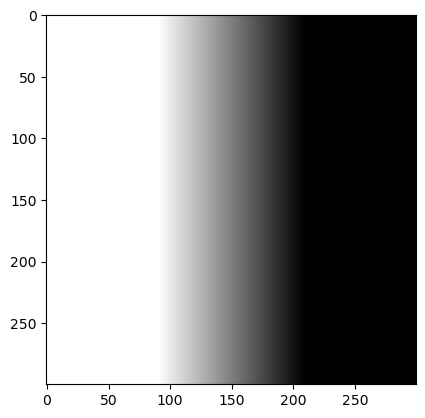

In [71]:
plt.imshow(twenty_percent_oraple_mask, cmap='gray')
plt.savefig('project2_images/twenty_percent_oraple_mask.jpg')
plt.show()


In [72]:
twenty_percent_apple_masked = []
twenty_percent_orange_masked = []
twenty_percent_recombined_image = []

twenty_percent_current_apple = None
twenty_percent_current_orange = None
twenty_percent_current_recombined = None

for i in range(5):
    twenty_percent_apple = apple_laplacian_stack[i] * twenty_percent_oraple_mask_gaussian_stack[i]
    twenty_percent_orange = orange_laplacian_stack[i] * (1 - twenty_percent_oraple_mask_gaussian_stack[i])
    twenty_percent_recombined = twenty_percent_apple + twenty_percent_orange

    twenty_percent_current_apple = twenty_percent_apple if twenty_percent_current_apple is None else twenty_percent_current_apple + twenty_percent_apple
    twenty_percent_current_orange = twenty_percent_orange if twenty_percent_current_orange is None else twenty_percent_current_orange + twenty_percent_orange
    twenty_percent_current_recombined = twenty_percent_apple + twenty_percent_orange if twenty_percent_current_recombined is None else twenty_percent_current_recombined + twenty_percent_apple + twenty_percent_orange

    twenty_percent_apple_masked.append(np.clip(twenty_percent_apple, 0, 1))
    twenty_percent_orange_masked.append(np.clip(twenty_percent_orange, 0, 1))
    twenty_percent_recombined_image.append(np.clip(twenty_percent_recombined, 0, 1))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


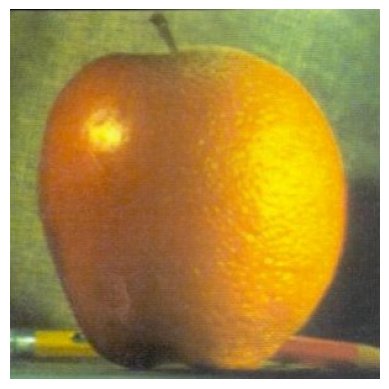

In [73]:
plt.imshow(twenty_percent_current_recombined)
plt.axis('off')
plt.savefig('project2_images/twenty_percent_recombined_oraple.jpg')

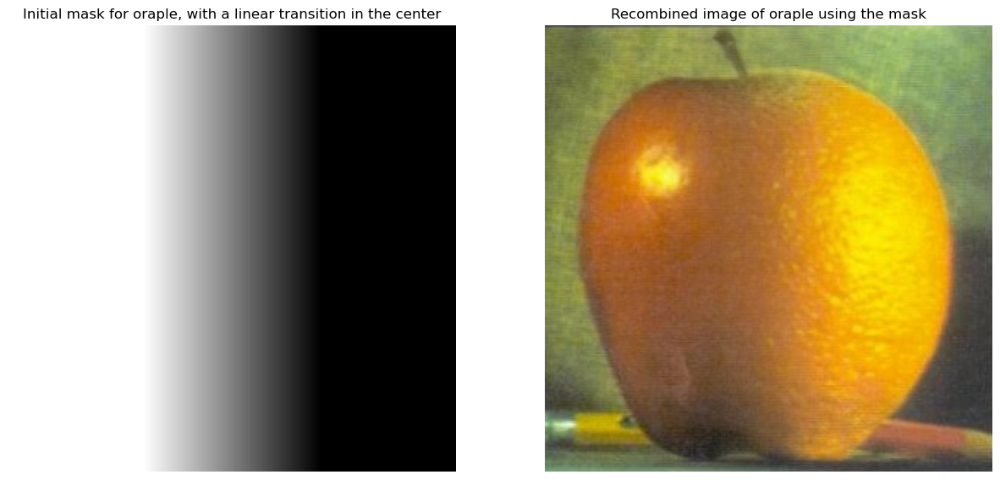

In [136]:
plt.figure(figsize=(15, 10))
plt.subplot(1, 2, 1)
plt.imshow(twenty_percent_oraple_mask, cmap='gray')
plt.axis('off')
plt.title('Initial mask for oraple, with a linear transition in the center')
plt.subplot(1, 2, 2)
plt.imshow(np.clip(twenty_percent_current_recombined, 0, 1))
plt.axis('off')
plt.title('Recombined image of oraple using the mask')
plt.savefig('project2_images/twenty_percent_recombined_oraple.jpg')
plt.show()

In [74]:
moon_image = cv2.imread('project2_images/moon.jpg', cv2.IMREAD_COLOR)
moon_image = cv2.cvtColor(moon_image, cv2.COLOR_BGR2RGB)
moon_image = moon_image.astype(np.float64) / 255.0

cheese_image = cv2.imread('project2_images/cheese_cropped.jpg', cv2.IMREAD_COLOR)
cheese_image = cv2.cvtColor(cheese_image, cv2.COLOR_BGR2RGB)
cheese_image = cheese_image.astype(np.float64) / 255.0
cheese_image = cv2.resize(cheese_image, (moon_image.shape[1], moon_image.shape[0]))

print(moon_image.shape)
print(cheese_image.shape)

(314, 330, 3)
(314, 330, 3)


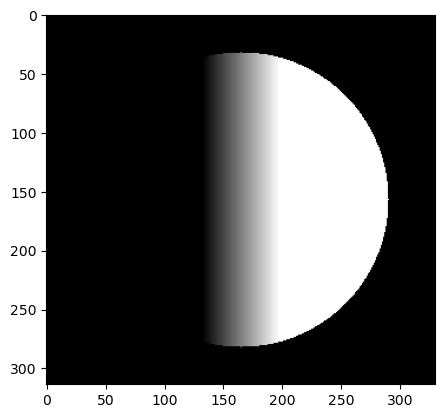

In [75]:
cheese_mask = np.zeros_like(moon_image[:,:,0])
height, width = moon_image.shape[:2]
center_x, center_y = width // 2, height // 2

y, x = np.ogrid[:height, :width]
y_full, x_full = np.broadcast_arrays(y, x)
distance = np.sqrt((x_full - center_x)**2 + (y_full - center_y)**2)

ten_percent = int(width * 0.1)
left_edge = center_x - ten_percent
right_edge = center_x + ten_percent
linear_transition = np.clip((x_full - left_edge) / (right_edge - left_edge), 0, 1)

circle_mask = distance <= 125
cheese_mask[circle_mask] = linear_transition[circle_mask]

plt.imshow(cheese_mask, cmap='gray')

In [76]:
cheese_mask_gaussian_stack = get_gaussian_stack(cheese_mask, starting_sigma = 1, num_levels = 5, sigma_step = 2)

In [77]:
moon_laplacian_stack = get_laplacian_stack(moon_image, starting_sigma = 1, num_levels = 5, sigma_step = 2)
cheese_laplacian_stack = get_laplacian_stack(cheese_image, starting_sigma = 1, num_levels = 5, sigma_step = 2)

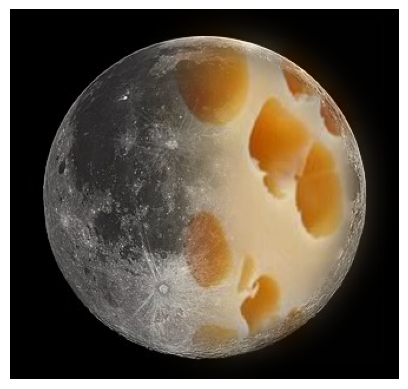

In [78]:
recombined_image = None

for i in range(5):
    moon_laplacian = moon_laplacian_stack[i]
    cheese_laplacian = cheese_laplacian_stack[i]
    cheese_mask_gaussian = cheese_mask_gaussian_stack[i]
    recombined_laplacian = cheese_laplacian * cheese_mask_gaussian + moon_laplacian * (1 - cheese_mask_gaussian)

    if recombined_image is None:
        recombined_image = recombined_laplacian
    else:
        recombined_image = recombined_image + recombined_laplacian

plt.imshow(np.clip(recombined_image, 0, 1))
plt.axis('off')
plt.savefig('project2_images/cheese_moon_recombined.jpg')
plt.show()


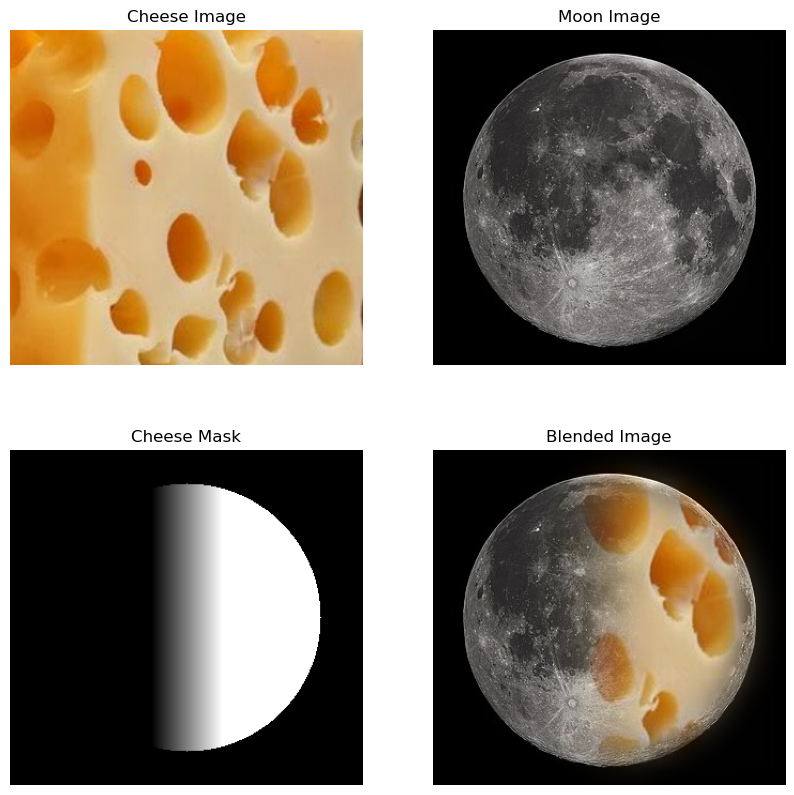

In [140]:
plt.figure(figsize=(10, 10))
plt.subplot(2, 2, 1)
plt.imshow(cheese_image)
plt.title('Cheese Image')
plt.axis('off')
plt.subplot(2, 2, 2)
plt.imshow(moon_image)
plt.title('Moon Image')
plt.axis('off')
plt.subplot(2, 2, 3)
plt.imshow(cheese_mask, cmap='gray')
plt.title('Cheese Mask')
plt.axis('off')
plt.subplot(2, 2, 4)
plt.imshow(np.clip(recombined_image, 0, 1))
plt.title('Blended Image')
plt.axis('off')
plt.savefig('project2_images/cheese_moon_recombined.jpg')
plt.show()

(1400, 800, 3)
(1400, 800, 3)


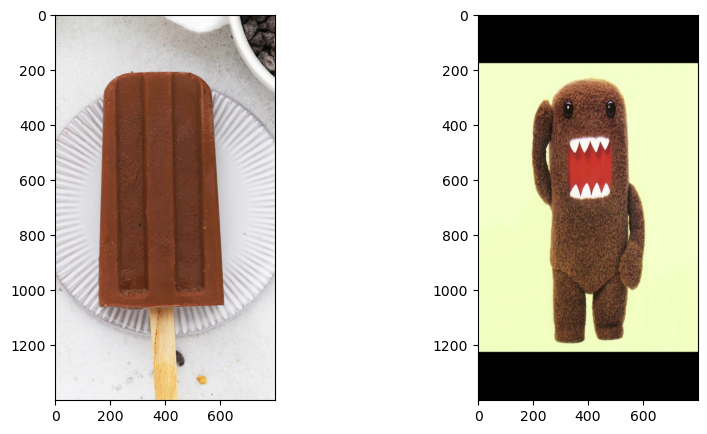

In [80]:
popsicle_image = cv2.imread('project2_images/chocolate_popsicle.jpg', cv2.IMREAD_COLOR)
popsicle_image = cv2.cvtColor(popsicle_image, cv2.COLOR_BGR2RGB)
popsicle_image = popsicle_image.astype(np.float64) / 255.0
popsicle_image = sktr.rotate(popsicle_image, -10, preserve_range=True)
popsicle_image = popsicle_image[200:-200, 200:-200, :]

domo_image = cv2.imread('project2_images/domo.jpeg', cv2.IMREAD_COLOR)
domo_image = cv2.cvtColor(domo_image, cv2.COLOR_BGR2RGB)
domo_image = domo_image.astype(np.float64) / 255.0
domo_image = np.pad(domo_image, ((100, 100), (0, 0), (0, 0)), mode='constant')
domo_image = cv2.resize(domo_image, (popsicle_image.shape[1], popsicle_image.shape[0]))

print(popsicle_image.shape)
print(domo_image.shape)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(popsicle_image)
plt.subplot(1, 2, 2)
plt.imshow(domo_image)
plt.show()

In [81]:
# got alignment points by running align_image_code.py in terminal
domo_popsicle_pts = ((378.66666666666663, 247.22727272727252), (391.9242424242424, 1019.9545454545454), (401.3939393939394, 286.9999999999998), (408.9696969696969, 847.6060606060605))

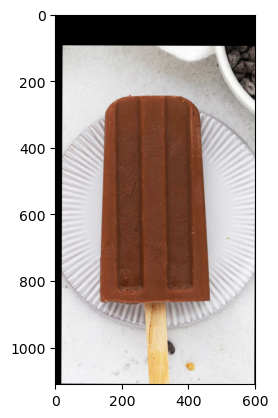

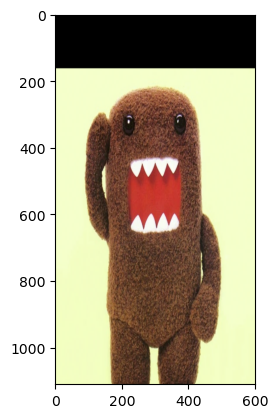

In [91]:
popsicle_aligned, domo_aligned = align_images_with_points(popsicle_image, domo_image, domo_popsicle_pts)
popsicle_aligned = popsicle_aligned[:, :]
popsicle_aligned = cv2.resize(popsicle_aligned, (domo_aligned.shape[1], domo_aligned.shape[0]))
plt.imshow(popsicle_aligned)
plt.show()
plt.imshow(domo_aligned)
plt.show()

In [83]:
x_min = domo_aligned.shape[1]//2 - 110
y_min = domo_aligned.shape[0]//2 - 275
rect_width = 225
rect_height = 450

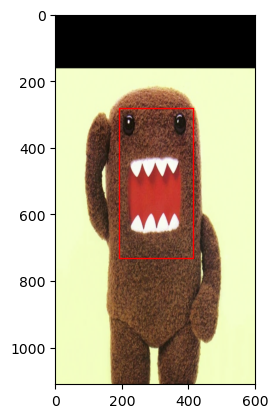

In [84]:
plt.imshow(domo_aligned)
ax = plt.gca()
rectangle = plt.Rectangle((x_min, y_min), rect_width, rect_height, fill=False, color='red')
ax.add_patch(rectangle)
plt.show()


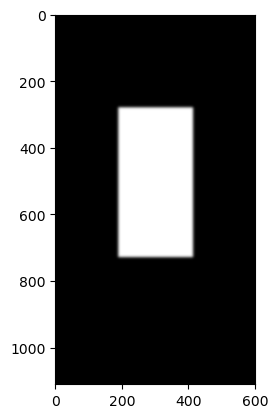

In [85]:
domo_mask = np.zeros_like(domo_aligned[:,:,0])
domo_mask[y_min:y_min+rect_height, x_min:x_min+rect_width] = 1
gaussian_kernel = cv2.getGaussianKernel(25, 4)
gaussian_kernel = np.outer(gaussian_kernel, gaussian_kernel)
domo_mask = scipy.signal.convolve2d(domo_mask, gaussian_kernel, mode='same', boundary='fill', fillvalue=0)
plt.imshow(domo_mask, cmap='gray')

In [86]:
domo_laplacian_stack = get_laplacian_stack(domo_aligned, starting_sigma = 1, num_levels = 5, sigma_step = 2)

In [92]:
popsicle_laplacian_stack = get_laplacian_stack(popsicle_aligned, starting_sigma = 1, num_levels = 5, sigma_step = 2)

In [88]:
domo_mask_gaussian_stack = get_gaussian_stack(domo_mask, starting_sigma = 1, num_levels = 5, sigma_step = 2)

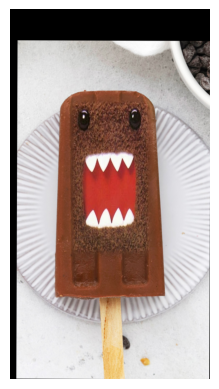

In [93]:
recombined_domo_popsicle = None

for i in range(5):
    domo_laplacian = domo_laplacian_stack[i]
    popsicle_laplacian = popsicle_laplacian_stack[i]
    domo_mask_gaussian = domo_mask_gaussian_stack[i]
    recombined_laplacian = domo_laplacian * domo_mask_gaussian + popsicle_laplacian * (1 - domo_mask_gaussian)

    if recombined_domo_popsicle is None:
        recombined_domo_popsicle = recombined_laplacian
    else:
        recombined_domo_popsicle = recombined_domo_popsicle + recombined_laplacian
        
plt.imshow(np.clip(recombined_domo_popsicle, 0, 1))
plt.axis('off')
plt.savefig('project2_images/domo_popsicle_recombined.jpg')
plt.show()

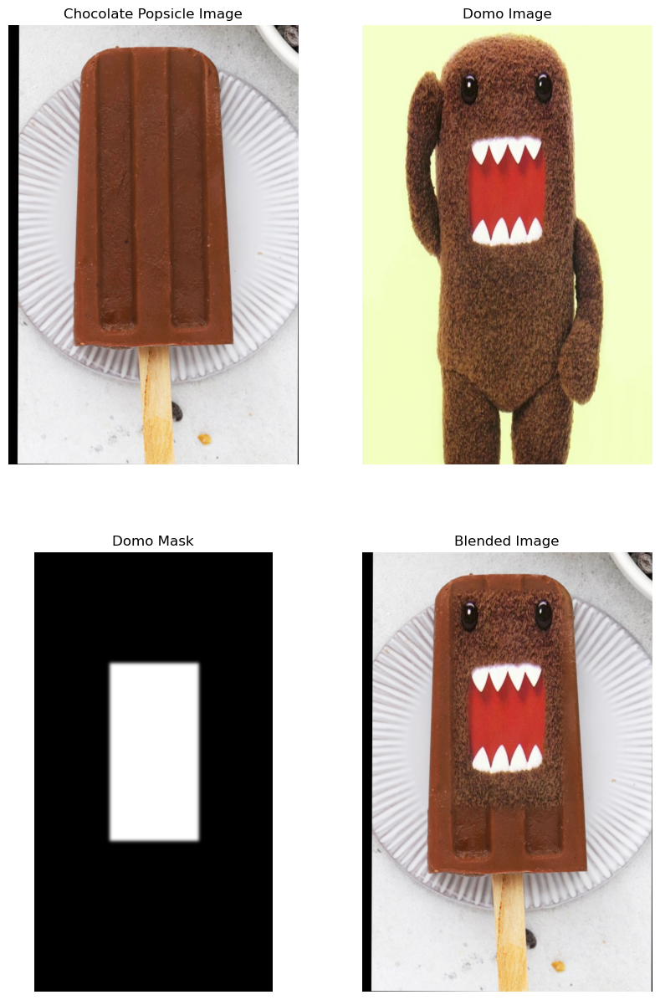

In [145]:
plt.figure(figsize=(10, 15))
plt.subplot(2, 2, 1)
plt.imshow(popsicle_aligned[200:, :, :])
plt.axis('off')
plt.title('Chocolate Popsicle Image')
plt.subplot(2, 2, 2)
plt.imshow(domo_aligned[200:, :, :])
plt.axis('off')
plt.title('Domo Image')
plt.subplot(2, 2, 3)
plt.imshow(domo_mask, cmap='gray')
plt.axis('off')
plt.title('Domo Mask')
plt.subplot(2, 2, 4)
plt.imshow(np.clip(recombined_domo_popsicle, 0, 1)[200:, :, :])
plt.axis('off')
plt.title('Blended Image')

plt.savefig('project2_images/domo_popsicle_recombined.jpg')
plt.show()
